Import package

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim 

from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

from torchvision.models import vgg19, VGG19_Weights

Configuration

In [2]:
device=torch.device('cuda' if torch.cuda.is_available() else 'cpu')
torch.set_default_device(device)

imsize=512

style_path='./data/images/style/The Starry Night.jpg'
content_path='./data/images/content/content_meme.jpg'

content_layer_default=['conv_3', 'conv_4']
style_layer_default=['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5','conv_6', 'conv_7', 'conv_8', 'conv_9', 'conv_10']

num_run=2000
style_weight=50000
content_weight=1

Loading data 

Oringal image

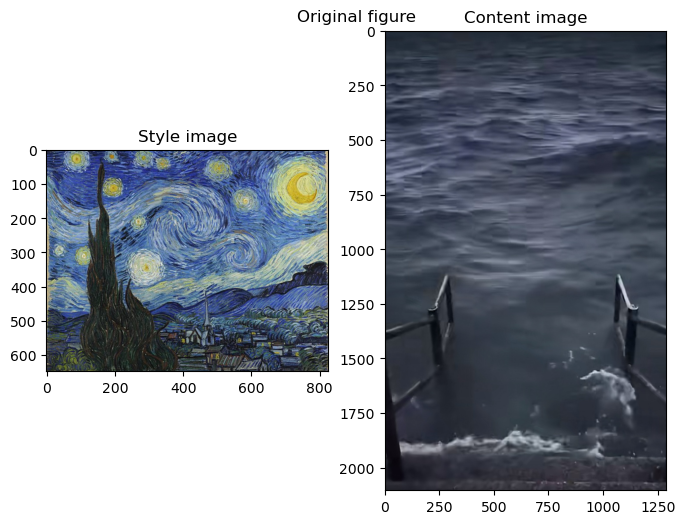

In [3]:
style_img=Image.open(style_path)
content_img=Image.open(content_path)

plt.figure(figsize=(8,6))
plt.axis('off')
plt.title('Original figure')

plt.subplot(1,2,1)
plt.imshow(style_img)
#plt.axis('off')
plt.title('Style image')

plt.subplot(1,2,2)
plt.imshow(content_img)
#plt.axis('off')
plt.title('Content image')

loader=transforms.Compose([transforms.Resize([imsize,imsize]), transforms.ToTensor()])

def image_loader(img_path):
    img=Image.open(img_path)
    img=loader(img).unsqueeze(0)
    return img

style_img=image_loader(style_path).to(device, torch.float)
content_img=image_loader(content_path).to(device, torch.float)

#assert style_img.size() == content_img.size()

Resize image

Text(0.5, 1.0, 'Content image')

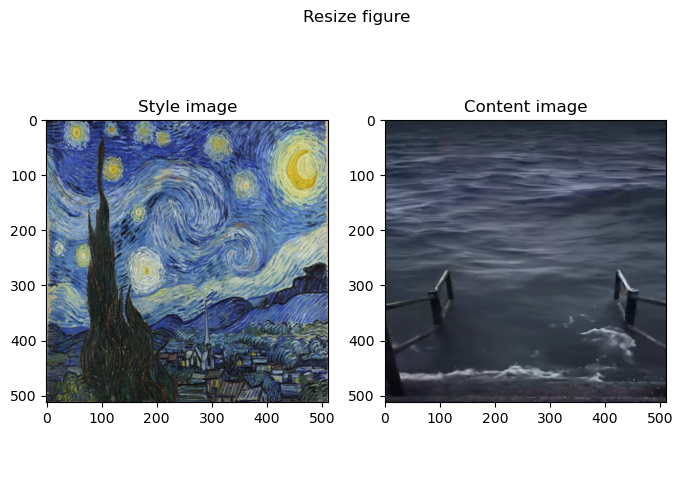

In [4]:
unloader=transforms.ToPILImage()
style_img_o=unloader(style_img.squeeze(0))
content_img_o=unloader(content_img.squeeze(0))

plt.figure(figsize=(8,6))
plt.title('Resize figure')
plt.axis('off')

plt.subplot(1,2,1)
plt.imshow(style_img_o)
plt.title('Style image')

plt.subplot(1,2,2)
plt.imshow(content_img_o)
plt.title('Content image')

Loss function

Content loss

In [5]:
class Contentloss(nn.Module):
    def __init__(self, target):
        super().__init__()
        self.target=target.detach()
        self.loss_fn=nn.MSELoss()
        
    def forward(self, input):
        self.loss=self.loss_fn(input, self.target)
        return input

Style loss

In [6]:
def gram_matrix(input):
    a, b, c, d=input.size()
    features=input.view(a*b,c*d)
    G=torch.mm(features, features.t())
    return G.div(a*b*c*d)

In [7]:
class Styleloss(nn.Module):
    def __init__(self, target_feature):
        super().__init__()
        self.target=gram_matrix(target_feature).detach()
        self.loss_fn=nn.MSELoss()
    def forward(self, input):
        G=gram_matrix(input)
        self.loss=self.loss_fn(self.target, G)
        return input

Import model

In [8]:
cnn=vgg19(weights=VGG19_Weights.DEFAULT).features.eval()

Normalization

In [9]:
cnn_normalization_mean=torch.tensor([0.485, 0.456, 0.406])
cnn_normalization_std=torch.tensor([0.229, 0.224, 0.225])

class Normalization(nn.Module):
    def __init__(self, mean, std):
        super().__init__()
        self.mean=mean.view(-1, 1, 1)
        self.std=std.view(-1,1,1)
    def forward(self,input):
        output=(input-self.mean)/self.std
        return output

Getting and adding layers from VGG19

In [10]:
normalize=Normalization(cnn_normalization_mean, cnn_normalization_std)
model=nn.Sequential(normalize)
model.to(device)

def get_layer_and_add_loss(cnn, model, content_img, style_img, content_layer, style_layer):
    i=0
    content_losses=[]
    style_losses=[]
    
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i+=1
            name='conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name='relu_{}'.format(i)
            layer=nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name='pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name='bl_{}'.format(i)
        else:
            raise RuntimeEroor('Unrecognized layer : {}'.format(layer.__class__.__name__))

        model.add_module(name,layer)
        model.to(device)
        
        if name in content_layer:
            target=model(content_img).detach()
            contentloss=Contentloss(target)
            model.add_module('content_loss_{}'.format(i), contentloss)
            content_losses.append(contentloss)
        if name in style_layer:
            print('i:{}, style:{}'.format(i,style_img.size()))
            target_feature=model(style_img).detach()
            styleloss=Styleloss(target_feature)
            model.add_module('style_loss_{}'.format(i), styleloss)
            style_losses.append(styleloss)

    for i in range(len(model)-1, -1, -1):
        if isinstance(model[i], Contentloss) or isinstance(model[i], Styleloss):
            break
    model=model[:(i+1)].to(device)
    return model, content_losses, style_losses

Input image(White noise)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.9275928..5.017247].


Text(0.5, 1.0, 'Input image')

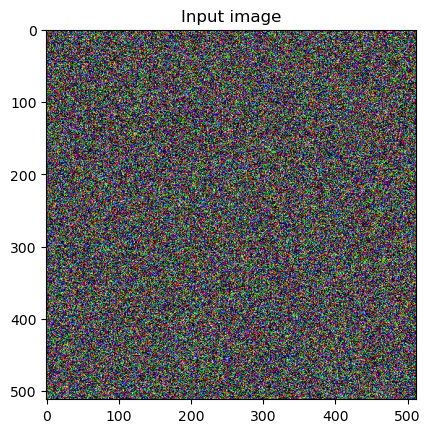

In [11]:
input_img=torch.randn(content_img.size())
input_medium=input_img.cpu()
plt.figure()
plt.imshow(input_medium.squeeze(0).permute(1,2,0))
plt.title('Input image')

In [12]:
input_img.size()

torch.Size([1, 3, 512, 512])

Optimizer(Gradient descent)

In [13]:
def optimizer_input_img(input_img):
    optimizer=optim.LBFGS([input_img])
    return optimizer

Generation loop

In [14]:
def run_model(cnn, model,content_img,style_img,content_layer,style_layer,input_img,num_run,content_weight,style_weight):

    print('Building neural transfer model.')
    model, content_losses, style_losses=get_layer_and_add_loss(cnn,model,content_img,style_img,content_layer,style_layer)

    input_img.requires_grad_(True)
    model.eval()
    model.requires_grad_(False)

    optimizer=optimizer_input_img(input_img)
    print('Optimizing')

    run=[0]

    while run[0]<=num_run:
        def closure():
            with torch.no_grad():
                input_img.clamp_(0,1)

            optimizer.zero_grad()
            model(input_img)
            content_score=0
            style_score=0

            for cl in content_losses:
                content_score+=cl.loss
            for sl in style_losses:
                style_score+=sl.loss

            content_score=content_score*content_weight
            style_score=style_score*style_weight
            loss=content_score+style_score

            loss.backward()
            
            run[0]+=1

            if run[0]%50==0:
                print('run: {}'.format(run))
                print('Content loss: {}, Style loss: {}'.format(content_score, style_score))

                input_medium=input_img.squeeze(0).cpu().detach()
                plt.figure()
                plt.ioff()
                plt.imshow(input_medium.permute(1,2,0))
                plt.title('run: {}'.format(run))
        
            return content_score+style_score

        optimizer.step(closure)

    with torch.no_grad():
        input_img.clamp(0,1)
    return input_img

Image generation !

Building neural transfer model.
i:1, style:torch.Size([1, 3, 512, 512])
i:2, style:torch.Size([1, 3, 512, 512])
i:3, style:torch.Size([1, 3, 512, 512])
i:4, style:torch.Size([1, 3, 512, 512])
i:5, style:torch.Size([1, 3, 512, 512])
i:6, style:torch.Size([1, 3, 512, 512])
i:7, style:torch.Size([1, 3, 512, 512])
i:8, style:torch.Size([1, 3, 512, 512])
i:9, style:torch.Size([1, 3, 512, 512])
i:10, style:torch.Size([1, 3, 512, 512])
Optimizing
run: [50]
Content loss: 43.129669189453125, Style loss: 55.27725601196289
run: [100]
Content loss: 37.964691162109375, Style loss: 10.134506225585938
run: [150]
Content loss: 33.595130920410156, Style loss: 5.325280666351318
run: [200]
Content loss: 30.48193359375, Style loss: 3.8858802318573
run: [250]
Content loss: 28.518321990966797, Style loss: 3.1613194942474365
run: [300]
Content loss: 27.13814926147461, Style loss: 2.77812123298645
run: [350]
Content loss: 26.21183204650879, Style loss: 2.5576446056365967
run: [400]
Content loss: 25.5330696105

C:\Users\pcgm6\AppData\Local\Temp\ipykernel_34220\2931008300.py:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


run: [1100]
Content loss: 40.972896575927734, Style loss: 40.23155212402344
run: [1150]
Content loss: 36.681297302246094, Style loss: 9.52200984954834
run: [1200]
Content loss: 32.88498306274414, Style loss: 5.292758464813232
run: [1250]
Content loss: 30.232688903808594, Style loss: 4.624028205871582
run: [1300]
Content loss: 28.573070526123047, Style loss: 3.830052375793457
run: [1350]
Content loss: 27.358936309814453, Style loss: 3.4014675617218018
run: [1400]
Content loss: 26.517047882080078, Style loss: 3.101078987121582
run: [1450]
Content loss: 25.939977645874023, Style loss: 2.8405559062957764
run: [1500]
Content loss: 25.394065856933594, Style loss: 2.8116657733917236
run: [1550]
Content loss: 25.146991729736328, Style loss: 2.454968214035034
run: [1600]
Content loss: 24.788307189941406, Style loss: 2.363964796066284
run: [1650]
Content loss: 24.743764877319336, Style loss: 2.792583465576172
run: [1700]
Content loss: 24.30035972595215, Style loss: 2.244816303253174
run: [1750]


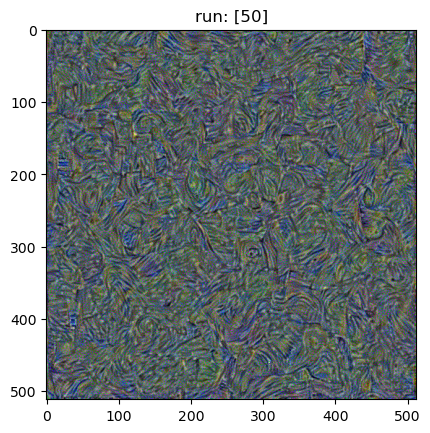

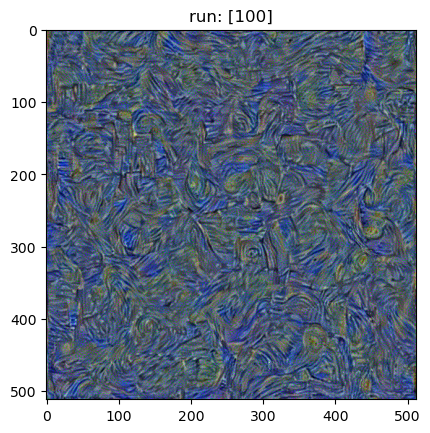

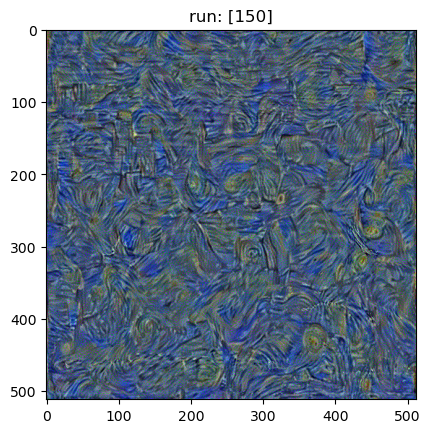

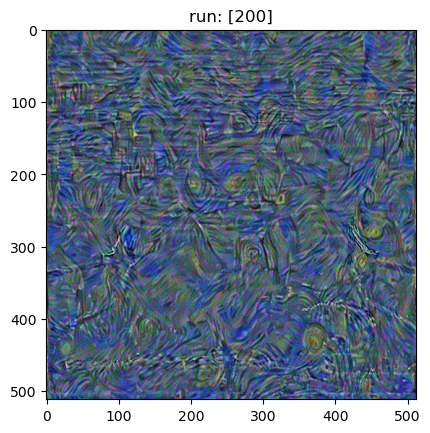

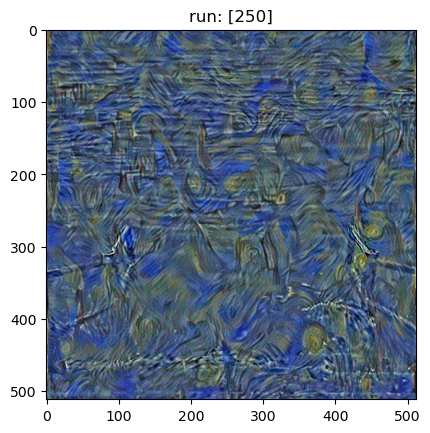

...

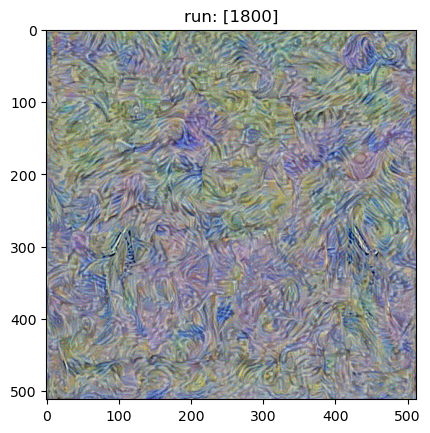

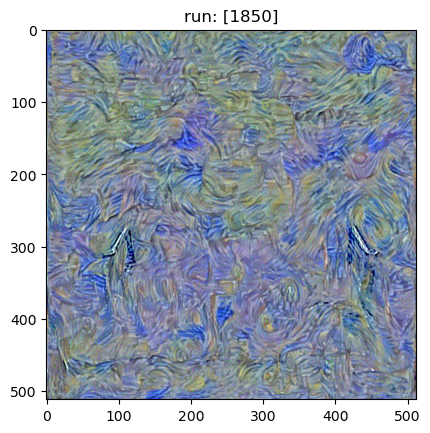

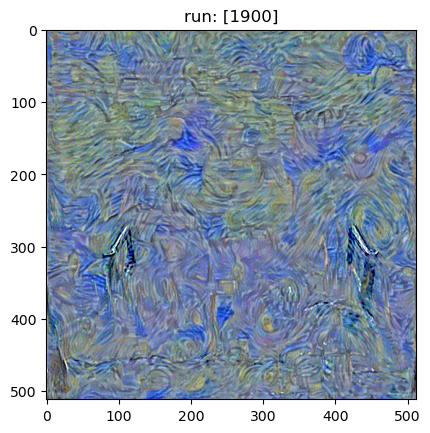

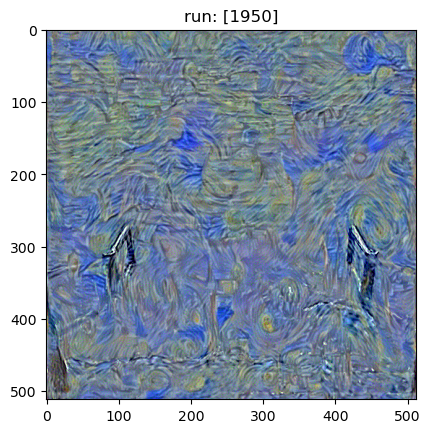

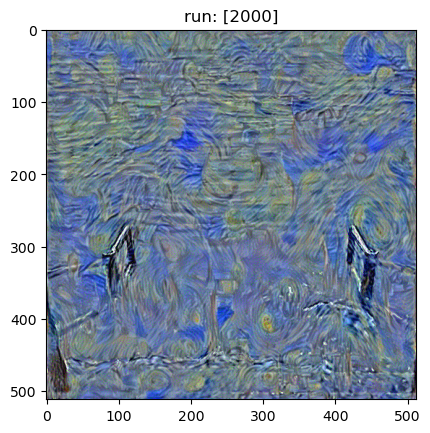

In [15]:
output_img=run_model(cnn, model,content_img,style_img,content_layer_default,style_layer_default,input_img,num_run,content_weight,style_weight)

In [16]:
model

Sequential(
  (0): Normalization()
  (conv_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (style_loss_1): Styleloss(
    (loss_fn): MSELoss()
  )
  (relu_1): ReLU()
  (conv_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (style_loss_2): Styleloss(
    (loss_fn): MSELoss()
  )
  (relu_2): ReLU()
  (pool_2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv_3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (content_loss_3): Contentloss(
    (loss_fn): MSELoss()
  )
  (style_loss_3): Styleloss(
    (loss_fn): MSELoss()
  )
  (relu_3): ReLU()
  (conv_4): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (content_loss_4): Contentloss(
    (loss_fn): MSELoss()
  )
  (style_loss_4): Styleloss(
    (loss_fn): MSELoss()
  )
  (relu_4): ReLU()
  (pool_4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv_5): Conv2d(128, 256, kernel_size=(3, 